## Import Libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.figure_factory as ff
import seaborn as sns

dataset = pd.read_csv("Dataset 3.csv")
dataset

,YEAR,MO,DY,HR,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M
0,2010,1,1,0:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97
1,2010,1,1,1:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92
2,2010,1,1,2:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12
3,2010,1,1,3:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88
4,2010,1,1,4:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...
70123,2017,12,31,19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86
70124,2017,12,31,20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75
70125,2017,12,31,21:00:00,24.87,19.41,22.14,14.04,71.62,0.0,100.78,1.66,296.93
70126,2017,12,31,22:00:00,24.74,18.89,21.82,13.55,69.88,0.0,100.78,1.48,303.61


In [ ]:
# convert the year, month, and day to date format
dataset.loc[:,'Date'] = pd.to_datetime(dataset.YEAR.astype(str) + ' ' + dataset.MO.astype(str) + ' ' + dataset.DY.astype(str) + ' ' + dataset.HR.astype(str))

In [ ]:
# remove the year, month and date columns
dataset = dataset.iloc[:, 4:]
# set the date as index
dataset.set_index('Date', inplace=True)
dataset

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M
Date,,,,,,,,,
2010-01-01 00:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97
2010-01-01 01:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92
2010-01-01 02:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12
2010-01-01 03:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88
2010-01-01 04:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58
...,...,...,...,...,...,...,...,...,...
2017-12-31 19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86
2017-12-31 20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75
2017-12-31 21:00:00,24.87,19.41,22.14,14.04,71.62,0.0,100.78,1.66,296.93


In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 70128 entries, 2010-01-01 00:00:00 to 2017-12-31 23:00:00
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   T2M          70128 non-null  float64
 1   T2MDEW       70128 non-null  float64
 2   T2MWET       70128 non-null  float64
 3   QV2M         70128 non-null  float64
 4   RH2M         70128 non-null  float64
 5   PRECTOTCORR  70128 non-null  float64
 6   PS           70128 non-null  float64
 7   WS10M        70128 non-null  float64
 8   WD10M        70128 non-null  float64
dtypes: float64(9)
memory usage: 5.4 MB


In [ ]:
dataset.describe()

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M
count,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000,70128.000000
mean,25.904549,23.521527,24.713027,18.183131,87.477036,0.337354,100.651882,2.398212,226.626938
std,2.261126,1.695625,1.594662,1.693558,11.172587,0.607365,0.201380,0.895252,52.344774
min,14.730000,9.400000,12.080000,7.320000,33.060000,0.000000,99.970000,0.020000,0.000000
25%,24.270000,23.150000,23.830000,17.700000,80.560000,0.030000,100.510000,1.870000,209.460000
50%,25.520000,23.870000,24.800000,18.490000,92.190000,0.150000,100.650000,2.280000,224.150000
75%,27.430000,24.470000,25.780000,19.170000,96.440000,0.410000,100.790000,2.840000,245.110000
max,33.730000,27.130000,29.130000,22.580000,100.000000,20.780000,101.350000,7.460000,359.880000


In [ ]:
# Function to plot interactive plots using Plotly Express
def interactive_plot(df, column, timestamp, title):
  '''
  df: dataframe, the dataset.
  column: str, name of column you want to plot
  title: str, title of the plot
  timestamp: str, column of the time for the time series data
  '''
  fig = px.line(title=title)
  for i in df[[column]]:
    fig.add_scatter(x=timestamp, y=df[i], name=i)
  fig.show()
              
interactive_plot(dataset, 'RH2M', dataset.index, 'Relative Humidity Data')       

In [ ]:
dataset['Next RH2M'] = dataset[['RH2M']].shift(-1)
dataset

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M,Next RH2M
Date,,,,,,,,,,
2010-01-01 00:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97,86.56
2010-01-01 01:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92,87.19
2010-01-01 02:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12,88.12
2010-01-01 03:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88,89.12
2010-01-01 04:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58,90.44
...,...,...,...,...,...,...,...,...,...,...
2017-12-31 19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86,72.56
2017-12-31 20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75,71.62
2017-12-31 21:00:00,24.87,19.41,22.14,14.04,71.62,0.0,100.78,1.66,296.93,69.88


In [ ]:
# Remove last nan row
dataset = dataset[:-1]
dataset

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M,Next RH2M
Date,,,,,,,,,,
2010-01-01 00:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97,86.56
2010-01-01 01:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92,87.19
2010-01-01 02:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12,88.12
2010-01-01 03:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88,89.12
2010-01-01 04:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58,90.44
...,...,...,...,...,...,...,...,...,...,...
2017-12-31 18:00:00,26.12,20.96,23.54,15.50,73.25,0.0,100.58,1.58,306.36,73.25
2017-12-31 19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86,72.56
2017-12-31 20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75,71.62


## Exploratory Data Analysis



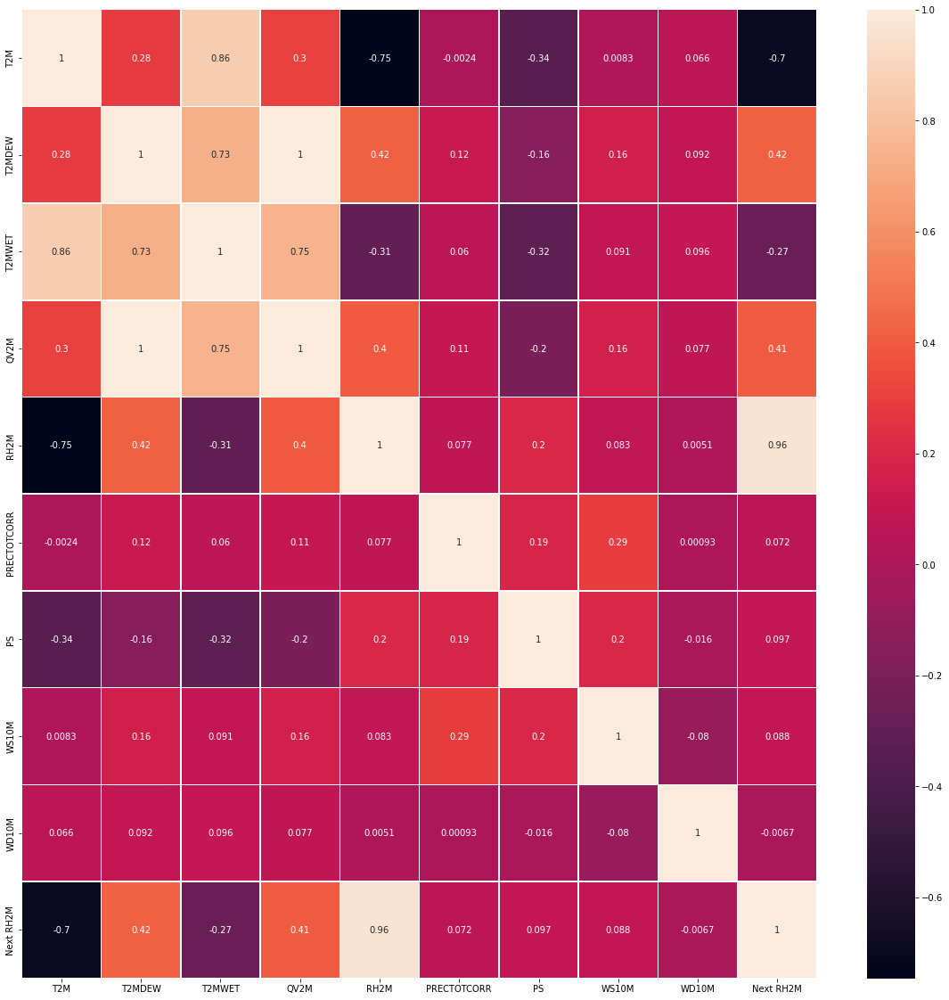

In [ ]:
# Pearson's Corrrelation Plot with Seaborn
fig, ax = plt.subplots(figsize=(20,20))  # Sample figsize in inches
sns.heatmap(dataset.corr(method='pearson'), annot=True, linewidths=.5, ax=ax)

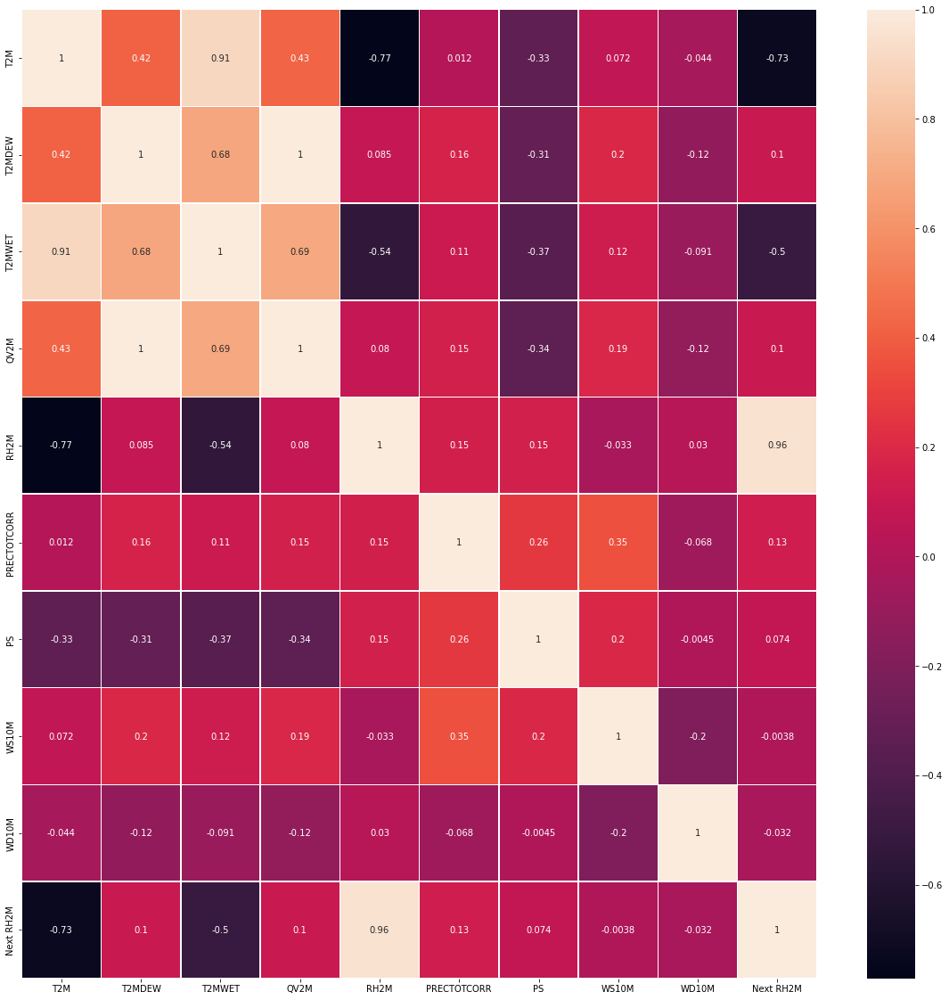

In [ ]:
# Pearson's Corrrelation Plot with Seaborn
fig, ax = plt.subplots(figsize=(20,20))  # Sample figsize in inches
sns.heatmap(dataset.corr(method='spearman'), annot=True, linewidths=.5, ax=ax)

There is a high positive correlation between the RH2M and Next RH2M. There is also a high negative correlation between relative humidity and temperature.

#### Visualization to see which features correlate with the future Relative Humidity

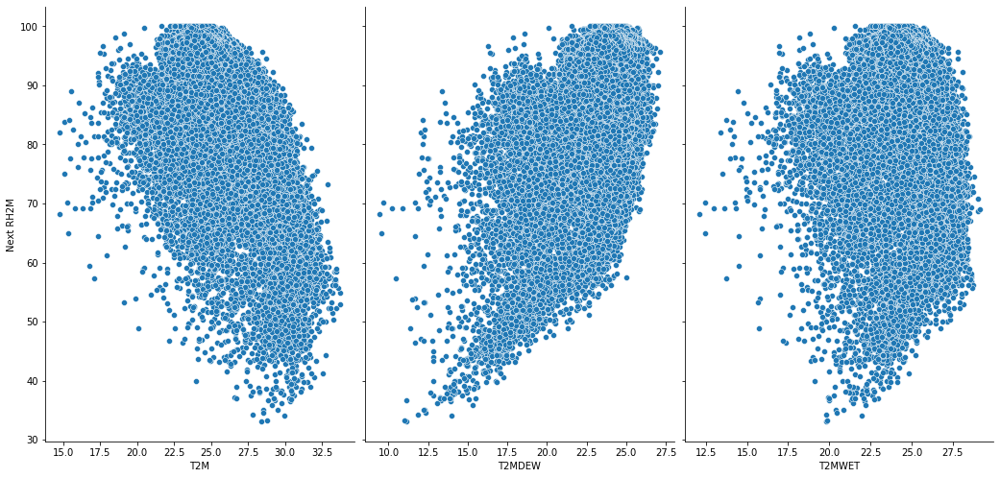

In [ ]:
sns.pairplot(dataset, x_vars=["T2M", "T2MDEW", "T2MWET"],
             y_vars=["Next RH2M"], height=7, aspect=0.7)

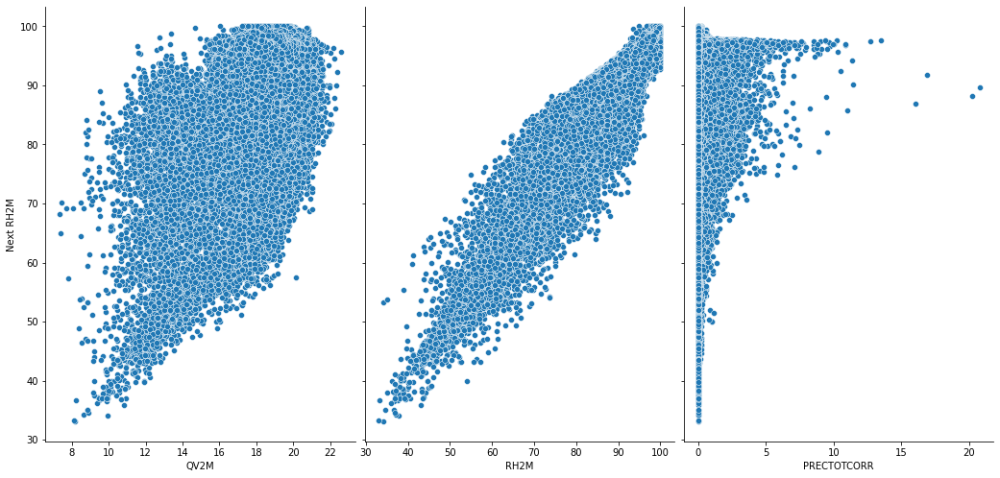

In [ ]:
sns.pairplot(dataset, x_vars=["QV2M", "RH2M", "PRECTOTCORR"],
             y_vars=["Next RH2M"], height=7, aspect=0.7)

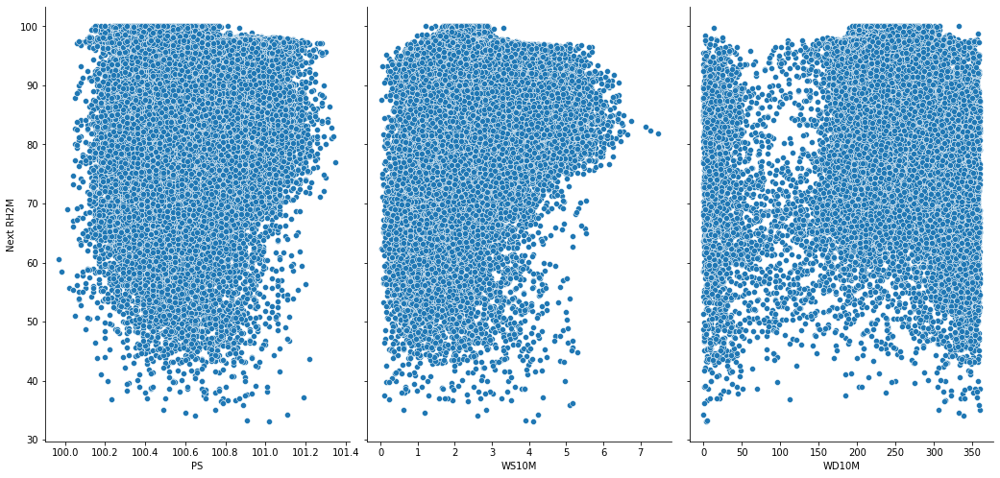

In [ ]:
sns.pairplot(dataset, x_vars=["PS", "WS10M", "WD10M"],
             y_vars=["Next RH2M"], height=7, aspect=0.7)

## Create Model to Predict Future Temperature

In [ ]:
rh_data = dataset[["T2M", "T2MDEW", "QV2M", "RH2M", "Next RH2M"]]
rh_data

,T2M,T2MDEW,QV2M,RH2M,Next RH2M
Date,,,,,
2010-01-01 00:00:00,24.37,21.81,16.30,85.56,86.56
2010-01-01 01:00:00,24.14,21.77,16.30,86.56,87.19
2010-01-01 02:00:00,23.99,21.75,16.24,87.19,88.12
2010-01-01 03:00:00,23.87,21.80,16.30,88.12,89.12
2010-01-01 04:00:00,23.74,21.85,16.36,89.12,90.44
...,...,...,...,...,...
2017-12-31 18:00:00,26.12,20.96,15.50,73.25,73.25
2017-12-31 19:00:00,25.40,20.30,14.83,73.25,72.56
2017-12-31 20:00:00,25.11,19.84,14.40,72.56,71.62


### Standardize the Data

In [ ]:
# Feature Scaling
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaled_rh_data = scaler.fit_transform(rh_data)

print("Mean of each column", scaler.mean_)
print("Variance of each column", scaler.var_)
scaled_rh_data

Mean of each column [25.90456771 23.52160052 18.18320219 87.47731002 87.47706319]
Variance of each column [  5.11266582   2.87476985   2.86778032 124.82141833 124.82663756]


array([[-0.67867578, -1.00948732, -1.11204922, -0.17161205, -0.08208156],
       [-0.78039526, -1.03307898, -1.11204922, -0.08210537, -0.02569354],
       [-0.84673406, -1.04487481, -1.14747981, -0.02571617,  0.05754594],
       ...,
       [-0.35140441, -2.17137644, -2.23401771, -1.33519888, -1.41928339],
       [-0.45754648, -2.42498676, -2.44660122, -1.41933516, -1.57502176],
       [-0.5150401 , -2.7316783 , -2.73595099, -1.57507678, -1.72091459]])

#### Remember, you can't use shuffle the data when splitting it to the train and test set because it is a time series data.

In [ ]:
# Create Matrix of Features and target variable without scaling**
X = scaled_rh_data[:, :-1]
y = scaled_rh_data[:, -1]
print("Matrix of features", X, sep='\n')
print("--------------------------------------------------")
print("Target Variable", y, sep='\n')
print("--------------------------------------------------")
print("Shape of the Matrix of features", X.shape, sep='\n')
print("Shape of the target variable", y.shape, sep='\n')

Matrix of features
[[-0.67867578 -1.00948732 -1.11204922 -0.17161205]
 [-0.78039526 -1.03307898 -1.11204922 -0.08210537]
 [-0.84673406 -1.04487481 -1.14747981 -0.02571617]
 ...
 [-0.35140441 -2.17137644 -2.23401771 -1.33519888]
 [-0.45754648 -2.42498676 -2.44660122 -1.41933516]
 [-0.5150401  -2.7316783  -2.73595099 -1.57507678]]
--------------------------------------------------
Target Variable
[-0.08208156 -0.02569354  0.05754594 ... -1.41928339 -1.57502176
 -1.72091459]
--------------------------------------------------
Shape of the Matrix of features
(70127, 4)
Shape of the target variable
(70127,)


In [ ]:
# Splitting Dataset into Training and Validation Set
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25,
                                                  shuffle=False)

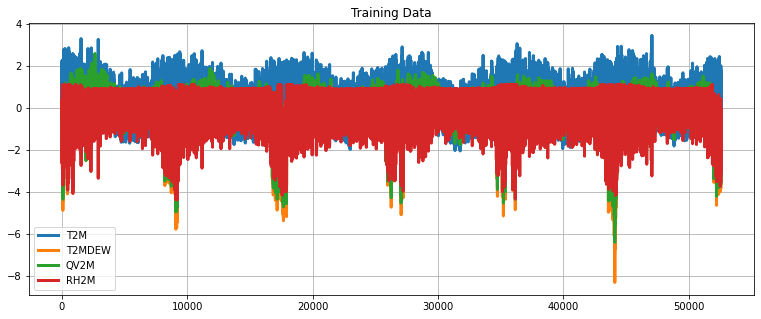

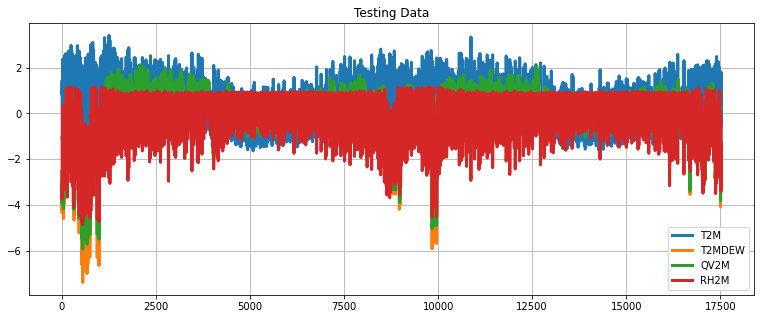

In [ ]:
# Define a data plotting function
def show_plot(data, title):
  plt.figure(figsize=(13, 5))
  plt.plot(data, linewidth=3)
  plt.title(title)
  plt.legend(["T2M", "T2MDEW", "QV2M", "RH2M"])
  plt.grid()

show_plot(X_train, "Training Data")
show_plot(X_val, "Testing Data")

## Ridge Regression

In [ ]:
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import Ridge

# fit model to training data
ridge_model = Ridge(alpha=0.5)
ridge_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_1 = ridge_model.predict(X_val)
print("R Squared on Validation Set: ", ridge_model.score(X_val, y_val))
print("RMSE of Ridge Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_1)))

R Squared on Validation Set:  0.9259892179577031
RMSE of Ridge Regressor:  0.28455262011950716


In [ ]:
from math import sqrt

# Make Predictions on the entire dataset
y_pred = ridge_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_rh_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Function to plot interactive plots using Plotly Express
def interactive_plot2(df, title):
  fig = px.line(title=title)
  for i in df.columns:
    fig.add_scatter(x=df.index, y=df[i], name=i)
  fig.show()

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Ridge)")

Model Prediction on entire dataset [-0.21530085 -0.12649754 -0.07606415 ... -1.35472426 -1.43729887
 -1.59126434]
Original y [86.56 87.19 88.12 ... 71.62 69.88 68.25]
Unstandardized y_pred [85.07159629 86.06375877 86.62723003 ... 72.34129231 71.41872058
 69.6985284 ]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00   86.56   85.071596
2010-01-01 01:00:00   87.19   86.063759
2010-01-01 02:00:00   88.12   86.627230
2010-01-01 03:00:00   89.12   87.546733
2010-01-01 04:00:00   90.44   88.535613
2010-01-01 05:00:00   92.00   89.822642
2010-01-01 06:00:00   91.44   91.315448
2010-01-01 07:00:00   84.88   90.994404
2010-01-01 08:00:00   77.69   84.777828
2010-01-01 09:00:00   69.62   77.910598
2010-01-01 10:00:00   64.19   70.243291
2010-01-01 11:00:00   60.94   65.111624
2010-01-01 12:00:00   59.00   62.065490
2010-01-01 13:00:00   57.88   60.253268
2010-01-01 14:00:00   58.31   59.185654


## Lasso Regression

In [ ]:
from sklearn.linear_model import Lasso

# fit model to training data
lasso_model = Lasso(alpha=0.0005)
lasso_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_2 = lasso_model.predict(X_val)
print("R Squared Lasso Regressor: ", lasso_model.score(X_val, y_val))
print("RMSE of Lasso Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_2)))

R Squared Lasso Regressor:  0.9258015981205261
RMSE of Lasso Regressor:  0.28491306708874903


In [ ]:
# Make Predictions on the entire dataset
y_pred = lasso_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_rh_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Lasso)")

Model Prediction on entire dataset [-0.19233934 -0.107307   -0.05472452 ... -1.32904299 -1.41490073
 -1.57092478]
Original y [86.56 87.19 88.12 ... 71.62 69.88 68.25]
Unstandardized y_pred [85.32813572 86.2781667  86.86564892 ... 72.62821853 71.66896562
 69.92577378]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00   86.56   85.328136
2010-01-01 01:00:00   87.19   86.278167
2010-01-01 02:00:00   88.12   86.865649
2010-01-01 03:00:00   89.12   87.760215
2010-01-01 04:00:00   90.44   88.721283
2010-01-01 05:00:00   92.00   89.986362
2010-01-01 06:00:00   91.44   91.468410
2010-01-01 07:00:00   84.88   91.116668
2010-01-01 08:00:00   77.69   84.972763
2010-01-01 09:00:00   69.62   78.153078
2010-01-01 10:00:00   64.19   70.398030
2010-01-01 11:00:00   60.94   65.171298
2010-01-01 12:00:00   59.00   62.026671
2010-01-01 13:00:00   57.88   60.139462
2010-01-01 14:00:00   58.31   59.031278


## Decision Tree Regression

In [ ]:
from sklearn.tree import DecisionTreeRegressor

# fit model to training data
dt_model = DecisionTreeRegressor(max_leaf_nodes=50,
                                 random_state=1)
dt_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_4 = dt_model.predict(X_val)
print("R Squared Decision Tree Regressor: ", dt_model.score(X_val, y_val))
print("RMSE of Decision Tree Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_4)))

R Squared Decision Tree Regressor:  0.9251850809593911
RMSE of Decision Tree Regressor:  0.2860942948545098


In [ ]:
# Make Predictions on the entire dataset
y_pred = dt_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_rh_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Decision Tree)")

Model Prediction on entire dataset [-0.21404395 -0.07486763 -0.07486763 ... -1.43864566 -1.59012331
 -1.59012331]
Original y [86.56 87.19 88.12 ... 71.62 69.88 68.25]
Unstandardized y_pred [85.0856391  86.64059829 86.64059829 ... 71.40367347 69.7112766
 69.7112766 ]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00   86.56   85.085639
2010-01-01 01:00:00   87.19   86.640598
2010-01-01 02:00:00   88.12   86.640598
2010-01-01 03:00:00   89.12   87.619043
2010-01-01 04:00:00   90.44   88.728325
2010-01-01 05:00:00   92.00   89.673867
2010-01-01 06:00:00   91.44   90.916404
2010-01-01 07:00:00   84.88   90.916404
2010-01-01 08:00:00   77.69   83.312197
2010-01-01 09:00:00   69.62   78.321168
2010-01-01 10:00:00   64.19   70.987126
2010-01-01 11:00:00   60.94   64.555542
2010-01-01 12:00:00   59.00   62.123635
2010-01-01 13:00:00   57.88   62.123635
2010-01-01 14:00:00   58.31   58.770790


## XGBoost Regressor

In [ ]:
from xgboost import XGBRegressor

# check for the best number of n_estimators
xgboost_model = XGBRegressor(n_estimators=1000, learning_rate=0.1, n_jobs=-1)
xgboost_model.fit(X_train, y_train,
                  early_stopping_rounds=20,
                  eval_set=[(X_val, y_val)],
                  verbose=True)

[11:22:41] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:1.0686
Will train until validation_0-rmse hasn't improved in 20 rounds.
[1]	validation_0-rmse:0.973328
[2]	validation_0-rmse:0.887921
[3]	validation_0-rmse:0.81175
[4]	validation_0-rmse:0.743896
[5]	validation_0-rmse:0.683983
[6]	validation_0-rmse:0.630547
[7]	validation_0-rmse:0.58342
[8]	validation_0-rmse:0.542228
[9]	validation_0-rmse:0.505623
[10]	validation_0-rmse:0.473727
[11]	validation_0-rmse:0.44633
[12]	validation_0-rmse:0.422638
[13]	validation_0-rmse:0.40167
[14]	validation_0-rmse:0.384283
[15]	validation_0-rmse:0.368588
[16]	validation_0-rmse:0.355662
[17]	validation_0-rmse:0.344301
[18]	validation_0-rmse:0.335092
[19]	validation_0-rmse:0.327573
[20]	validation_0-rmse:0.320738
[21]	validation_0-rmse:0.31525
[22]	validation_0-rmse:0.310593
[23]	validation_0-rmse:0.306647
[24]	validation_0-rmse:0.302936
[25]	validation_0-rmse:0.

XGBRegressor(n_estimators=1000, n_jobs=-1)

In [ ]:
# fit model to training data
from xgboost import XGBRegressor
xgboost_model = XGBRegressor(n_estimators=726, learning_rate=0.1)
xgboost_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_5 = xgboost_model.predict(X_val)
print("R Squared XGBoost Regressor: ", xgboost_model.score(X_val, y_val))
print("RMSE of XGBoost Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_5)))

[11:23:14] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
R Squared XGBoost Regressor:  0.9338540896352832
RMSE of XGBoost Regressor:  0.269008864477967


In [ ]:
# Make Predictions on the entire dataset
y_pred = xgboost_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_rh_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (XGBoost)")

Model Prediction on entire dataset [-0.1958493  -0.09781057 -0.07543039 ... -1.421332   -1.5110326
 -1.676372  ]
Original y [86.56 87.19 88.12 ... 71.62 69.88 68.25]
Unstandardized y_pred [85.288925 86.38427  86.634315 ... 71.597115 70.594925 68.74766 ]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00   86.56   85.288925
2010-01-01 01:00:00   87.19   86.384270
2010-01-01 02:00:00   88.12   86.634315
2010-01-01 03:00:00   89.12   87.807175
2010-01-01 04:00:00   90.44   88.491356
2010-01-01 05:00:00   92.00   89.781075
2010-01-01 06:00:00   91.44   91.074898
2010-01-01 07:00:00   84.88   90.855476
2010-01-01 08:00:00   77.69   85.095856
2010-01-01 09:00:00   69.62   76.685959
2010-01-01 10:00:00   64.19   69.500641
2010-01-01 11:00:00   60.94   65.395935
2010-01-01 12:00:00   59.00   62.018845
2010-01-01 13:00:00   57.88   60.470711
2010-01-01 14:00:00   58.31   59.416161
